This file is meant to learn how to take the fft of songs and find its characteristics in the frequency domain. 

In [13]:
import numpy as np
import os
import matplotlib.pyplot as plt
import math
from scipy import signal
from IPython.display import Audio
from scipy.io import wavfile

audio_fs = 44100

In [2]:
def sig2db(mag_spec):
    return 20*np.log10(mag_spec)

In [5]:
fs, music_stereo = wavfile.read('music_samples_wav/chicago.wav') # Import the sound file
fs_1, music_stereo_1 = wavfile.read('music_samples_wav/Hallelujah_16k.wav')
fs_2, music_stereo_2 = wavfile.read('music_samples_wav/Chicago-benny_goodman.wav')
# music_mono = music_stereo[:,0] # To obtain mono sound track
print("Fs: {}".format(fs))
print("type of array: {}".format(type(music_stereo)))
np.savetxt("OutputText/file1.txt", music_stereo, fmt="%d")
Audio(music_stereo, rate = fs)
# Audio(music_mono, rate = audio_fs)

/tmp/ipykernel_679/3016088602.py:2: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fs_1, music_stereo_1 = wavfile.read('music_samples_wav/Hallelujah_16k.wav')
/tmp/ipykernel_679/3016088602.py:3: WavFileWarning: Reached EOF prematurely; finished at 34529359 bytes, expected 4294967303 bytes from header.
  fs_2, music_stereo_2 = wavfile.read('music_samples_wav/Chicago-benny_goodman.wav')


Fs: 16000
type of array: <class 'numpy.ndarray'>


In [7]:
# determing the data type of the wavfile numpy array
print("Dtype: {}".format(music_stereo[0].dtype))
print("Dtype: {}".format(music_stereo[1].dtype))

Dtype: int16
Dtype: int16


In [5]:
def zero_pad(samples):
    num_samples = len(samples)
    num_zeros = 0
    new_len = len(samples)
    power = math.log2(num_samples)
    whole = power.is_integer()
    print(num_samples)
    print(power)
    print(power.is_integer())
    if not whole:
        power = int(power) + 1
        new_len = pow(2, power)
        print(new_len)
        num_zeros = new_len - num_samples
        zeros = np.zeros(num_zeros)
        zero_padded = np.append(np.array(samples), zeros)
        return zero_padded
    else:
        return samples


In [19]:
zero_pad(music_mono)

13005776
23.632649145611026
False
16777216


(32727, 2)


C:\Users\flaco\AppData\Local\Temp\ipykernel_12580\1601750177.py:1: WavFileWarning: Chunk (non-data) not understood, skipping it.
  rate, aud_data = wavfile.read('music_samples/Hallelujah_16k.wav')


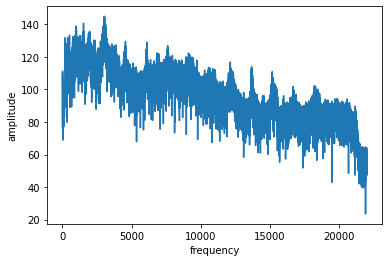

In [58]:

rate, aud_data = wavfile.read('music_samples_wav/Hallelujah_16k.wav')
print(aud_data.shape)
aud_data = aud_data[:,0]
# rate = 44000
# ii = np.arange(0, 9218368)
# t = ii / rate
# aud_data = np.zeros(len(t))
# for w in [1000, 5000, 10000, 15000]:
#     aud_data += np.cos(2 * np.pi * w * t)

# From here down, everything else can be the same
len_data = len(aud_data)

channel_1 = np.zeros(2**(int(np.ceil(np.log2(len_data)))))
channel_1[0:len_data] = aud_data

fourier = np.fft.fft(channel_1)
w = np.linspace(0, 44000, len(fourier))

# First half is the real component, second half is imaginary
fourier_to_plot = fourier[0:len(fourier)//2]
w = w[0:len(fourier)//2]

plt.figure(1)

plt.plot(w, sig2db(fourier_to_plot))
plt.xlabel('frequency')
plt.ylabel('amplitude')
plt.show()

8632320
23.041316915829444
False
16777216


Text(0, 0.5, 'Magnitude Response')

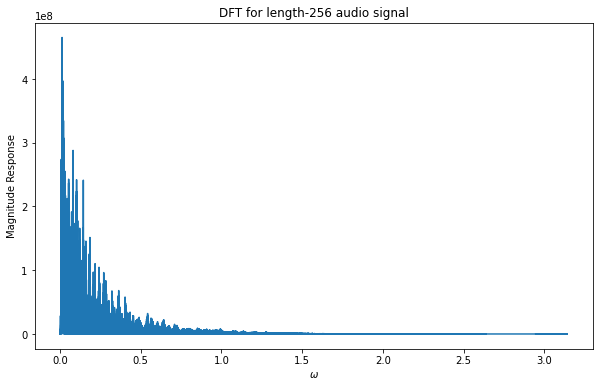

In [17]:
N = 256
# music_mono_short = music_mono[:N] # if we are only given the first 256 samples

music_mono_short = zero_pad(music_mono)
# print(music_mono)
# print(music_mono_short)

fft_short = np.fft.rfft(music_mono_short)
# fft_short = np.fft.fft(music_mono_short)
omega = np.linspace(0,np.pi,len(fft_short)) 
# omega = np.linspace(-np.pi, np.pi, len(fft_short))
plt.figure(figsize =(10,6))
plt.plot(omega, abs(fft_short))
# plt.plot(omega, fft_short)
plt.title('DFT for length-256 audio signal')
plt.xlabel(r'$\omega$')
plt.ylabel('Magnitude Response')

C:\Users\flaco\AppData\Local\Temp\ipykernel_12580\2690012408.py:2: RuntimeWarning: divide by zero encountered in log10
  return 20*np.log10(mag_spec)


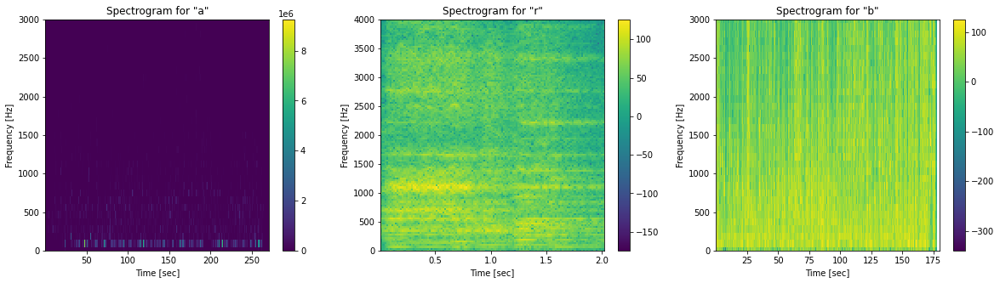

In [67]:
nfft = 512
# nfft = 4800
# noverlap = nfft//8
op = int(nfft/2)
f_a, t_a, S_a = signal.spectrogram(music_stereo[:,0], fs, nperseg = nfft, noverlap = op, nfft = nfft)
f_r, t_r, S_r = signal.spectrogram(music_stereo_1[:,0], fs_1, nperseg = nfft, noverlap = op, nfft = nfft)
f_b, t_b, S_b = signal.spectrogram(music_stereo_2[:,0], fs_2, nperseg = nfft, noverlap = op, nfft = nfft)

plt.figure(figsize=(20,5))
plt.subplot(131)
plt.pcolormesh(t_a, f_a, sig2db(S_a))
plt.title('Spectrogram for "a"')
plt.ylim([0, 3000])
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.colorbar()
plt.subplot(132)
plt.pcolormesh(t_r, f_r, sig2db(S_r))
plt.title('Spectrogram for "r"')
plt.ylim([0, 4000])
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.colorbar()
plt.subplot(133)
plt.pcolormesh(t_b, f_b, sig2db(S_b))
plt.title('Spectrogram for "b"')
plt.ylim([0, 3000])
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.colorbar()


Below is an attempt at using numpy's stft. The stft is short for Short Time Fourier Transform. It is used to quantify the change of a nonstationary signal's frequency and phase content over time. Ultimately, that means that this function is best for signals whose frequency content does not remain constant. This is of course the case for the frequency content of songs, thus the use of the stft. 

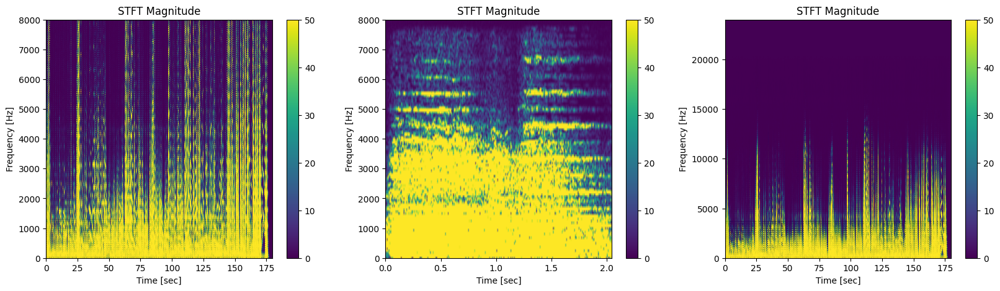

In [12]:
amp = 50 # not sure what the amplitude of songs would be
f, t, Zxx = signal.stft(music_stereo, fs) #, nperseg=1000)
plt.figure(figsize=(20,5))
plt.subplot(131)
plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=amp, shading='gouraud')
plt.title("STFT Magnitude")
plt.ylabel("Frequency [Hz]")
plt.xlabel("Time [sec]")
plt.colorbar()
plt.subplot(132)
f, t, Zxx = signal.stft(music_stereo_1[:,0], fs_1)
plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=amp, shading='gouraud')
plt.title("STFT Magnitude")
plt.ylabel("Frequency [Hz]")
plt.xlabel("Time [sec]")
plt.colorbar()
plt.subplot(133)
f, t, Zxx = signal.stft(music_stereo_2[:,0], fs_2)
plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=amp, shading='gouraud')
plt.title("STFT Magnitude")
plt.ylabel("Frequency [Hz]")
plt.xlabel("Time [sec]")
plt.colorbar()


Below is the stft of 10 hiphop songs from the music dataset

Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/hiphop/hiphop.00023.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/hiphop/hiphop.00005.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/hiphop/hiphop.00038.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/hiphop/hiphop.00089.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/hiphop/hiphop.00011.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/hiphop/hiphop.00050.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/hiphop/hiphop.00020.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/hiphop/hiphop.00057.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/hiphop/hiphop.00025.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/hiphop/hiphop.00013.wav


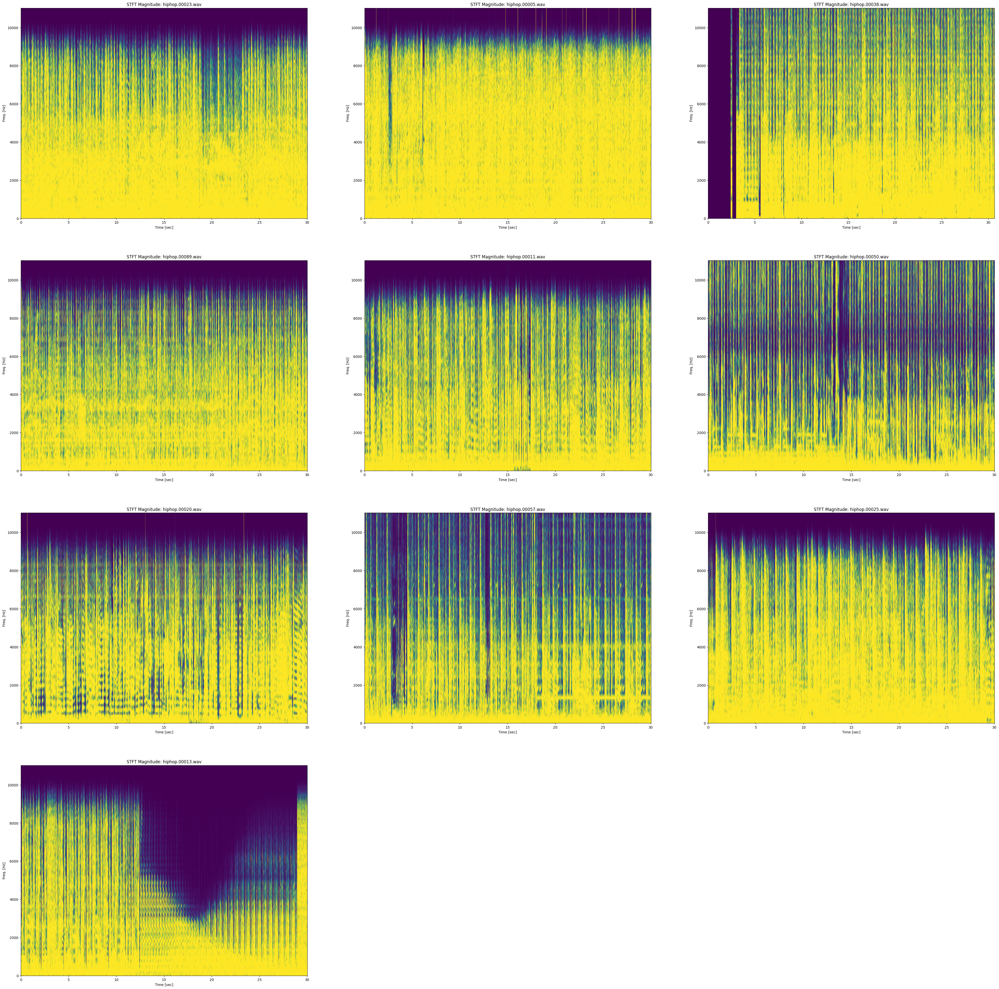

In [30]:
cwd = os.getcwd()
hiphop_local_path = '/GTZAN/hiphop/'
hiphop_path = cwd + hiphop_local_path
hiphop_songs = os.listdir(hiphop_path)
hiphop_dict_stereo = {}
hiphop_dict_freq = {}
amp = 50

idx = 0
for song in hiphop_songs:
    if idx == 10:
        break
    print("Path: {}".format(hiphop_path + song))
    temp_f, temp_stereo = wavfile.read(hiphop_path + song) # Import the sound file
    hiphop_dict_stereo[song] = temp_stereo
    hiphop_dict_freq[song] = temp_f
    idx += 1

plt.figure(figsize=(50, 50))

idx = 0
for key, temp_fs in hiphop_dict_freq.items():
    if idx == 10:
        break
    temp_stereo = hiphop_dict_stereo[key]
    f, t, Zxx = signal.stft(temp_stereo, temp_fs)
    plt.subplot(4, 3, idx+1)
    plt.title("STFT Magnitude: {}".format(key))
    plt.ylabel("Freq. [Hz]")
    plt.xlabel("Time [sec]")
    plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=amp, shading='gouraud')
    idx += 1

plt.show()

Below is the stft output of 10 songs from the classical dataset

Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/classical/classical.00060.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/classical/classical.00072.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/classical/classical.00040.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/classical/classical.00014.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/classical/classical.00079.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/classical/classical.00011.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/classical/classical.00001.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/classical/classical.00048.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/classical/classical.00085.wav
Path: /home/jchavez/Documents/PersonalProjects/MusicClassification/GTZAN/

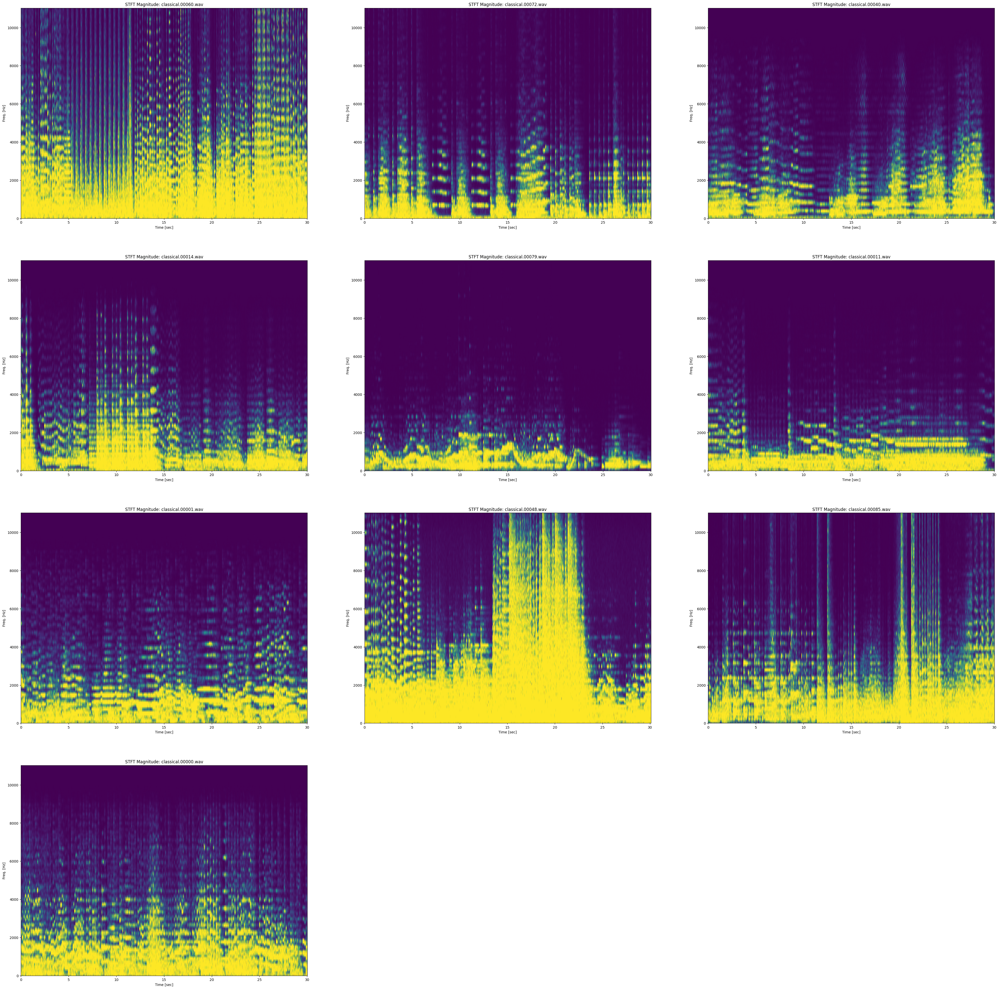

In [31]:
cwd = os.getcwd()
classical_local_path = '/GTZAN/classical/'
classical_path = cwd + classical_local_path
classical_songs = os.listdir(classical_path)
classical_dict_stereo = {}
classical_dict_freq = {}
amp = 50

idx = 0
for song in classical_songs:
    if idx == 10:
        break
    print("Path: {}".format(classical_path + song))
    temp_f, temp_stereo = wavfile.read(classical_path + song) # Import the sound file
    classical_dict_stereo[song] = temp_stereo
    classical_dict_freq[song] = temp_f
    idx += 1

plt.figure(figsize=(50, 50))

idx = 0
for key, temp_fs in classical_dict_freq.items():
    if idx == 10:
        break
    temp_stereo = classical_dict_stereo[key]
    f, t, Zxx = signal.stft(temp_stereo, temp_fs)
    plt.subplot(4, 3, idx+1)
    plt.title("STFT Magnitude: {}".format(key))
    plt.ylabel("Freq. [Hz]")
    plt.xlabel("Time [sec]")
    plt.pcolormesh(t, f, np.abs(Zxx), vmin=0, vmax=amp, shading='gouraud')
    idx += 1

plt.show()